# Proyecto Final _TAM

Diego Alejandro Arboleda Cuero

In [1]:
#librerias necesarias
!sudo apt-get update
!sudo apt-get install -y xvfb ffmpeg freeglut3-dev
!pip install 'imageio==2.4.0'
!pip install pyvirtualdisplay
!pip install tf-agents[reverb]
!pip install pyglet
!pip install swig
!pip install gym[atari,box2d,accept-rom-license]  #install gym and virtual display

Get:1 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:3 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:4 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:5 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:6 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:8 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,321 kB]
Hit:9 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:10 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,235 kB]
Hit:11 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:12 https://r2u.stat.illinois.edu/ubuntu jammy/main amd64 Packages [2,664 kB]
Hit:13 https://ppa.launchpadconten

In [2]:

# @title Librerias 

from __future__ import absolute_import, division, print_function

import base64
import imageio
import IPython
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import pyvirtualdisplay
import reverb

import tensorflow as tf

from tf_agents.agents.dqn import dqn_agent
from tf_agents.drivers import py_driver
from tf_agents.environments import suite_gym
from tf_agents.environments import tf_py_environment
from tf_agents.eval import metric_utils
from tf_agents.metrics import tf_metrics
from tf_agents.networks import sequential
from tf_agents.policies import py_tf_eager_policy
from tf_agents.policies import random_tf_policy
from tf_agents.replay_buffers import reverb_replay_buffer
from tf_agents.replay_buffers import reverb_utils
from tf_agents.trajectories import trajectory
from tf_agents.specs import tensor_spec
from tf_agents.utils import common

from tf_agents.environments import  suite_gym
from tf_agents.environments.atari_preprocessing import AtariPreprocessing
from tf_agents.environments.atari_wrappers import FrameStack4
import gym

# To get smooth animations
import matplotlib.animation as animation
matplotlib.rc('animation', html='jshtml')

In [3]:

#Carregando - Tetris
env = suite_gym.load(environment_name="ALE/Tetris-v5",max_episode_steps=2700, gym_env_wrappers=[AtariPreprocessing,FrameStack4])
env


In [4]:
env.gym

<FrameStack4<AtariPreprocessing<TimeLimit<OrderEnforcing<AtariEnv<ALE/Tetris-v5>>>>>>

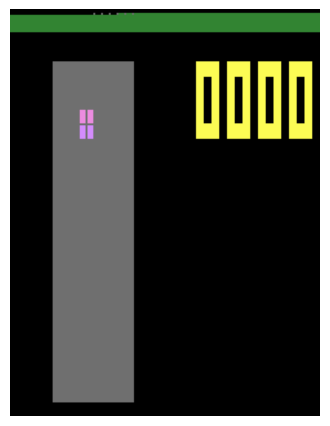

In [5]:
env.seed(42)
env.reset()
img = env.render(mode="rgb_array")
plt.figure(figsize=(4, 6))
plt.imshow(img)
plt.axis("off")
plt.show()

In [6]:
# Set up a virtual display for rendering OpenAI gym environments.
display = pyvirtualdisplay.Display(visible=0, size=(1400, 900)).start()

In [7]:
tf.version.VERSION

'2.15.1'

## Espacio de acciones y de observaciones

In [8]:
print('Acciones disponibles:\n{}\r\n'.format(env.gym.get_action_meanings()))
print('Observaciones:\n{}'.format(env.observation_spec()))

Acciones disponibles:
['NOOP', 'FIRE', 'RIGHT', 'LEFT', 'DOWN']

Observaciones:
BoundedArraySpec(shape=(84, 84, 4), dtype=dtype('uint8'), name='observation', minimum=0, maximum=255)


## Wrappers Agents

In [9]:
#Aquí está la lista de wrappers disponibles:
import tf_agents.environments.wrappers

for name in dir(tf_agents.environments.wrappers):
    obj = getattr(tf_agents.environments.wrappers, name)
    if hasattr(obj, "__base__") and issubclass(obj, tf_agents.environments.wrappers.PyEnvironmentBaseWrapper):
        print("{:27s} {}".format(name, obj.__doc__.split("\n")[0]))

ActionClipWrapper           Wraps an environment and clips actions to spec before applying.
ActionDiscretizeWrapper     Wraps an environment with continuous actions and discretizes them.
ActionOffsetWrapper         Offsets actions to be zero-based.
ActionRepeat                Repeates actions over n-steps while acummulating the received reward.
ExtraDisabledActionsWrapper Adds extra unavailable actions.
FixedLength                 Truncates long episodes and pads short episodes to have a fixed length.
FlattenActionWrapper        Flattens the action.
FlattenObservationsWrapper  Wraps an environment and flattens nested multi-dimensional observations.
GoalReplayEnvWrapper        Adds a goal to the observation, used for HER (Hindsight Experience Replay).
HistoryWrapper              Adds observation and action history to the environment's observations.
ObservationFilterWrapper    Filters observations based on an array of indexes.
OneHotActionWrapper         Converts discrete action to one_h

## Acciones de tetris

(84, 84, 4)


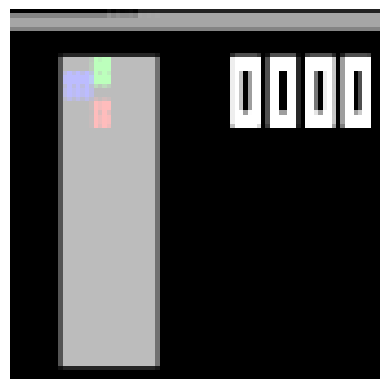

In [10]:
#Algunos ejemplos de acciones en el juego
env.reset()
time_step = env.step(np.array(0)) # NOOP
time_step = env.step(np.array(3)) # LEFT
time_step = env.step(np.array(4)) # DOWN

observation = time_step.observation.astype(np.float32)

#Como existen 3 canales de colores, no podemos mostrar 4 frames.
image = observation[..., :3]
image = np.clip(image / 150, 0, 1)
plt.imshow(image)
plt.axis("off")
print(observation.shape)

In [11]:
from tf_agents.environments.tf_py_environment import TFPyEnvironment
tf_env = TFPyEnvironment(env)

## DQN

In [12]:
from tf_agents.networks.q_network import QNetwork
#convertir observacinoes a float float 32, normalizando.. (valores  0.0 a 1.0) 
preprocessing_layer = tf.keras.layers.Lambda( lambda obs: tf.cast(obs, np.float32) / 255.)

#arquitectura:
#conv_layer_params=[(32, (8, 8), 4), (64, (4, 4), 2), (64, (3, 3), 1)]
conv_layer_params=[(32, (8, 8), 4) , (64, (4, 4), 2)]#, (64, (3, 3), 1), (1024, (7, 7), 1)]
#layer dense com 512 por uma cama de sair de 4 unidades
fc_layer_params=(1024,)

q_network = QNetwork(tf_env.observation_spec(), tf_env.action_spec()
                     ,preprocessing_layers=preprocessing_layer
                     ,conv_layer_params=conv_layer_params
                     ,fc_layer_params=fc_layer_params)
q_network.summary

<bound method Network.summary of <tf_agents.networks.q_network.QNetwork object at 0x7bfbf078dbd0>>

## DQN Agent

In [13]:
from tf_agents.agents.dqn.dqn_agent import DqnAgent

train_step = tf.Variable(0)
update_period = 4 
#optimizer = keras.optimizers.Adam(lr=2.5e-4, rho=0.95, momentum=0.1,epsilon=0.00001, centered=True)
optimizer = tf.compat.v1.train.RMSPropOptimizer(learning_rate=2.5e-4, decay=0.95, momentum=0.0,
                                     epsilon=0.00001, centered=True)
#optimizer = keras.optimizers.Adam(lr=0.00005,epsilon=0.00001)
epsilon_fn = tf.keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=0.8,
    decay_steps=250000 // update_period, 
    end_learning_rate=0.01)

agent = DqnAgent(tf_env.time_step_spec(),
                 tf_env.action_spec(),
                 q_network=q_network,
                 optimizer=optimizer,
                 target_update_period=2000, 
                 #La función de pérdida debe devolver un error por instancia, por lo que definimos reducción="none" 
                 td_errors_loss_fn=tf.keras.losses.Huber(reduction="none"),
                 gamma=0.89, # discount factor
                 train_step_counter=train_step,
                 epsilon_greedy=lambda: epsilon_fn(train_step))
agent.initialize()

## Buffer

In [14]:
from tf_agents.replay_buffers import tf_uniform_replay_buffer

#data_spec datos que se guardarán en el búfer.
#batch_size es el número de trayectorias que se deben agregar a cada paso.
#max_length es la longitud máxima de reproducción. (Documento DQN2015: Cuidado con el acaparador de RAM)

replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer( data_spec=agent.collect_data_spec,    batch_size=tf_env.batch_size, max_length=300000)#ojo para el entrenamiento

replay_buffer_observer = replay_buffer.add_batch

## Metricas

In [15]:
from tf_agents.metrics import tf_metrics
from tf_agents.eval.metric_utils import log_metrics
import logging

train_metrics = [
    tf_metrics.NumberOfEpisodes(),
    tf_metrics.EnvironmentSteps(),
    tf_metrics.AverageReturnMetric(),
    tf_metrics.AverageEpisodeLengthMetric(),
]
logging.getLogger().setLevel(logging.INFO)
log_metrics(train_metrics)

## Collect Driver

In [16]:
from tf_agents.drivers.dynamic_step_driver import DynamicStepDriver

collect_driver = DynamicStepDriver(
    tf_env,
    agent.collect_policy,
    observers=[replay_buffer_observer] + train_metrics,
    num_steps=update_period) 
collect_driver

In [17]:
from tf_agents.policies.random_tf_policy import RandomTFPolicy

class ShowProgress:
    def __init__(self, total):
        self.counter = 0
        self.total = total
    def __call__(self, trajectory):
        if not trajectory.is_boundary():
            self.counter += 1
        if self.counter % 100 == 0:
            print("\r{}/{}".format(self.counter, self.total), end="")

initial_collect_policy = RandomTFPolicy(tf_env.time_step_spec(),
                                        tf_env.action_spec())
init_driver = DynamicStepDriver(
    tf_env,
    initial_collect_policy,
    observers=[replay_buffer.add_batch, ShowProgress(20000)],
    num_steps=20000)
final_time_step, final_policy_state = init_driver.run()

20000/20000

In [18]:
#Ejemplo de la trayectoria final de un episodio
trajectories, buffer_info = replay_buffer.get_next(sample_batch_size=2, num_steps=17)
trajectories, buffer_info, trajectories._fields

(Trajectory(
 {'step_type': <tf.Tensor: shape=(2, 17), dtype=int32, numpy=
 array([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1],
        [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]], dtype=int32)>,
  'observation': <tf.Tensor: shape=(2, 17, 84, 84, 4), dtype=uint8, numpy=
 array([[[[[ 0,  0,  0,  0],
           [ 0,  0,  0,  0],
           [ 0,  0,  0,  0],
           ...,
           [20, 20, 20, 20],
           [20, 20, 20, 20],
           [20, 20, 20, 20]],
 
          [[78, 78, 78, 78],
           [78, 78, 78, 78],
           [78, 78, 78, 78],
           ...,
           [98, 98, 98, 98],
           [98, 98, 98, 98],
           [98, 98, 98, 98]],
 
          [[98, 98, 98, 98],
           [98, 98, 98, 98],
           [98, 98, 98, 98],
           ...,
           [98, 98, 98, 98],
           [98, 98, 98, 98],
           [98, 98, 98, 98]],
 
          ...,
 
          [[ 0,  0,  0,  0],
           [ 0,  0,  0,  0],
           [ 0,  0,  0,  0],
           ...,
           [ 

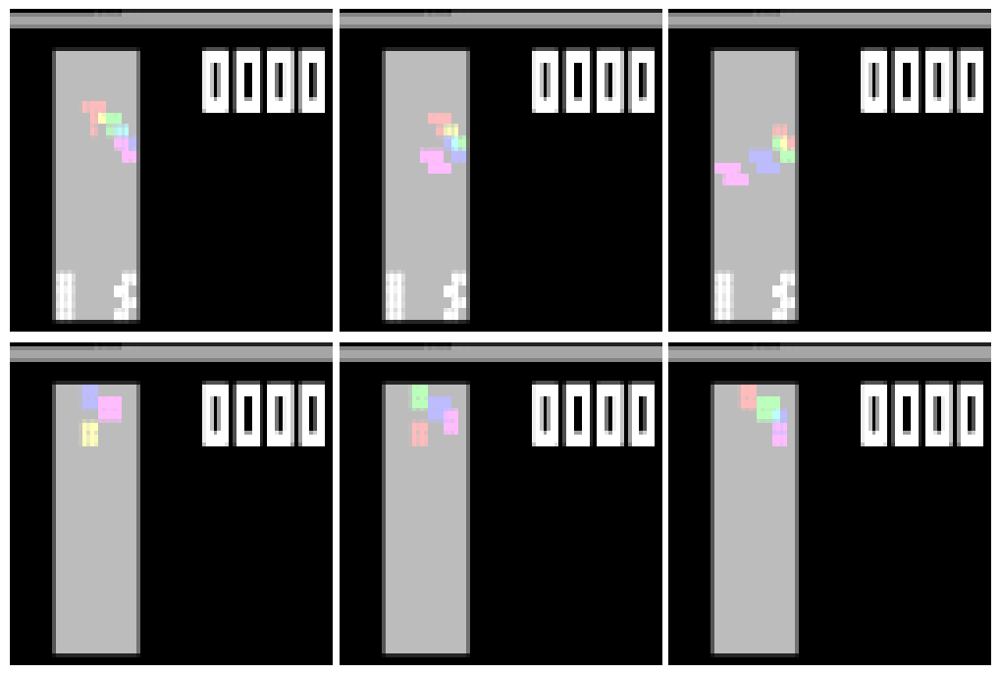

In [19]:
from tf_agents.trajectories.trajectory import to_transition

time_steps, action_steps, next_time_steps = to_transition(trajectories)
time_steps.observation.shape,trajectories.step_type.numpy()


plt.figure(figsize=(10, 6.8))
for row in range(2):
    for col in range(3):
        plt.subplot(2, 3, row * 3 + col + 1)
        obs = trajectories.observation[row, col].numpy().astype(np.float32)
        img = obs[..., :3]
        current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
        img[..., 0] += current_frame_delta
        img[..., 2] += current_frame_delta
        img = np.clip(img / 150, 0, 1)
        plt.imshow(img)
        plt.axis("off")
plt.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0, wspace=0.02)
plt.show()

## Dataset

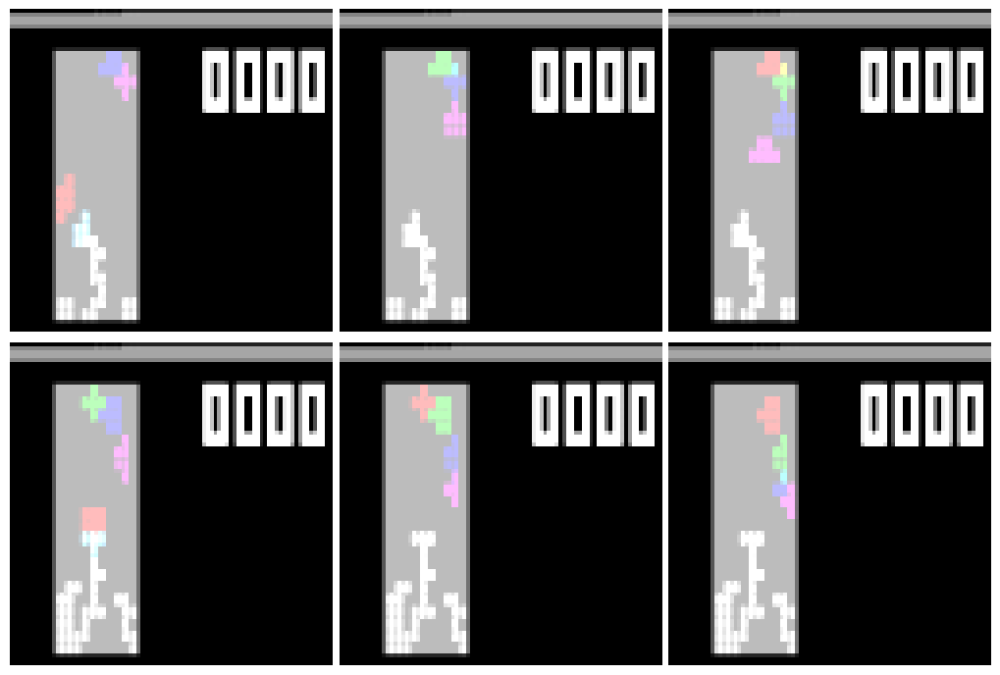

In [20]:
dataset = replay_buffer.as_dataset(
    sample_batch_size=64,
    num_steps=17,
    num_parallel_calls=3
).prefetch(3)
iterator = iter(dataset)
trajectories, buffer_info = next(iterator)
plt.figure(figsize=(10, 6.8))
for row in range(2):
    for col in range(3):
        plt.subplot(2, 3, row * 3 + col + 1)
        obs = trajectories.observation[row, col].numpy().astype(np.float32)
        img = obs[..., :3]
        current_frame_delta = np.maximum(obs[..., 3] - obs[..., :3].mean(axis=-1), 0.)
        img[..., 0] += current_frame_delta
        img[..., 2] += current_frame_delta
        img = np.clip(img / 150, 0, 1)
        plt.imshow(img)
        plt.axis("off")
plt.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0, wspace=0.02)
plt.show()


In [21]:
dataset = replay_buffer.as_dataset(
    sample_batch_size=64,
    num_steps=2,
    num_parallel_calls=3).prefetch(3)

## Training Loop

In [22]:
def train_agent(n_iterations):
    time_step = None
    policy_state = agent.collect_policy.get_initial_state(tf_env.batch_size)
    iterator = iter(dataset)
    reward_history = []  # Lista para almacenar recompensas
    
    for iteration in range(n_iterations):
        time_step, policy_state = collect_driver.run(time_step, policy_state)
        trajectories, buffer_info = next(iterator)
        train_loss = agent.train(trajectories)
        
        # Obtener y guardar la recompensa promedio
        avg_reward = train_metrics[0].result().numpy()
        reward_history.append(avg_reward)
        
        print("\r{} loss: {:.5f}, avg_reward: {:.2f}".format(
            iteration, train_loss.loss.numpy(), avg_reward), end="")
        
        if iteration % 1000 == 0:
            log_metrics(train_metrics)
    
       
    # Graficar la evolución de la recompensa
    plt.figure(figsize=(10,5))
    plt.plot(reward_history, label='Recompensa promedio durante entrenamiento')
    plt.xlabel('Iteraciones')
    plt.ylabel('Recompensa')
    plt.title('Evolución de la recompensa durante el entrenamiento')
    plt.legend()
    plt.show()
    
   


99999 loss: 0.00000, avg_reward: 2666.00

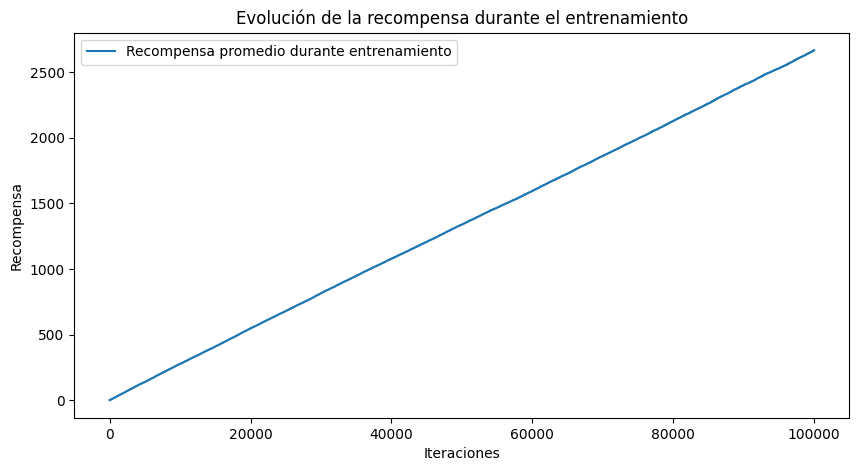

In [23]:

num_iterations_ = 100000
train_agent(n_iterations=num_iterations_)

## Visualization

In [24]:
def update_scene(num, frames, patch):
    patch.set_data(frames[num])
    return patch

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

In [25]:
frames = []
def save_frames(trajectory):
    global frames
    frames.append(tf_env.pyenv.envs[0].render(mode="rgb_array"))

prev_lives = tf_env.pyenv.envs[0].ale.lives()
def reset_and_fire_on_life_lost(trajectory):
    global prev_lives
    lives = tf_env.pyenv.envs[0].ale.lives()
    if prev_lives != lives:
        tf_env.reset()
        tf_env.pyenv.envs[0].step(np.array(tf_env.pyenv.envs[0].action_space.sample()))
        prev_lives = lives

watch_driver = DynamicStepDriver(
    tf_env,
    agent.policy,
    observers=[save_frames, reset_and_fire_on_life_lost, ShowProgress(10000)],
    num_steps=10000)
final_time_step, final_policy_state = watch_driver.run()

plot_animation(frames)

10000/10000

In [26]:
#Creando un gif
import PIL
import os

image_path = os.path.join("view1.gif")
frame_images = [PIL.Image.fromarray(frame) for frame in frames[:150]]
frame_images[0].save(image_path, format='GIF',
                     append_images=frame_images[1:],
                     save_all=True,
                     duration=300,
                     loop=0)

In [27]:
%%html
<img src="view9e5.gif" />